# *Group Exam INFO284 V21*

# *SALE PRICE PREDICTION NYC SALES*

### **Members: Didrik Nettelhorst Krog, Jonas Bech Holtan, Gunnar Hole Gjengedal, Snorre Alvsvåg**


## Introduction
### The task
You are supposed to build at least five machine learning models from these data to predict or
classify one relevant target feature for new data points. You can choose target feature yourself, but
sales price is perhaps the most suitable. You may also reduce the number of data points somewhat
by focusing on only specific meaningful parts of the data. Or perhaps you will try dimension
reduction.

### Our Approach
This task can be split into four parts:
- **Part 1** Data Exploration
- **Part 2** Data Cleaning
- **Part 3** Model Building
- **Part 4** Presentation and Analysation

We will explore our data by conducting a *Exploratory Data Analysis*. Here we will look at the data and make note of important features, non important features, and in general inform ourselves with the data. In part 2, we will generally clean the data, remove empty or unique columns and so on. In part 3 we will start to fit the models, we will also change the data in preparation of each model. And at last we will present the results, and analyze the different approaches we took with out models.

We have chosen these supervised machine learning algorythms:
- Decision Tree Regressor
- Random Forest Regressor
- Gradient Boosting Regressor

- Linear Reggresion 
- Ridge Reggression
- Lasso Regression
- Neural Network (MLPRegressor)

- Support Vector Machine (SVM)

- Gaussian Naive Bayes
- Bernoulli Naive Bayes

We have chosen one unsupervised machine learning algorythms:
- Clustering

Moving forward we will start by learing about our data

# Importing Data and Others

In [1]:
import pandas as pd
from collections import Counter
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re

df = pd.read_csv('nyc-rolling-sales.csv')

from sklearn.model_selection import train_test_split

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import BernoulliNB
from sklearn.cluster import KMeans
from sklearn.svm import LinearSVR, SVR, NuSVR 

from sklearn.preprocessing import LabelEncoder

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

from sklearn.decomposition import PCA
from sklearn.model_selection import GridSearchCV

# Presenting the Data

In [2]:
df.head(10)

,Unnamed: 0,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,EASE-MENT,BUILDING CLASS AT PRESENT,ADDRESS,...,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE
0,4,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2A,392,6,,C2,153 AVENUE B,...,5,0,5,1633,6440,1900,2,C2,6625000,2017-07-19 00:00:00
1,5,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2,399,26,,C7,234 EAST 4TH STREET,...,28,3,31,4616,18690,1900,2,C7,-,2016-12-14 00:00:00
2,6,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2,399,39,,C7,197 EAST 3RD STREET,...,16,1,17,2212,7803,1900,2,C7,-,2016-12-09 00:00:00
3,7,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2B,402,21,,C4,154 EAST 7TH STREET,...,10,0,10,2272,6794,1913,2,C4,3936272,2016-09-23 00:00:00
4,8,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2A,404,55,,C2,301 EAST 10TH STREET,...,6,0,6,2369,4615,1900,2,C2,8000000,2016-11-17 00:00:00
5,9,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2,405,16,,C4,516 EAST 12TH STREET,...,20,0,20,2581,9730,1900,2,C4,-,2017-07-20 00:00:00
6,10,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2B,406,32,,C4,210 AVENUE B,...,8,0,8,1750,4226,1920,2,C4,3192840,2016-09-23 00:00:00
7,11,1,ALPHABET CITY,07 RENTALS - WALKUP APARTMENTS,2,407,18,,C7,520 EAST 14TH STREET,...,44,2,46,5163,21007,1900,2,C7,-,2017-07-20 00:00:00
8,12,1,ALPHABET CITY,08 RENTALS - ELEVATOR APARTMENTS,2,379,34,,D5,141 AVENUE D,...,15,0,15,1534,9198,1920,2,D5,-,2017-06-20 00:00:00
9,13,1,ALPHABET CITY,08 RENTALS - ELEVATOR APARTMENTS,2,387,153,,D9,629 EAST 5TH STREET,...,24,0,24,4489,18523,1920,2,D9,16232000,2016-11-07 00:00:00


In [3]:
df.tail(10)

,Unnamed: 0,BOROUGH,NEIGHBORHOOD,BUILDING CLASS CATEGORY,TAX CLASS AT PRESENT,BLOCK,LOT,EASE-MENT,BUILDING CLASS AT PRESENT,ADDRESS,...,RESIDENTIAL UNITS,COMMERCIAL UNITS,TOTAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,TAX CLASS AT TIME OF SALE,BUILDING CLASS AT TIME OF SALE,SALE PRICE,SALE DATE
84538,8404,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7316,61,,B2,178 DARNELL LANE,...,2,0,2,3215,1300,1995,1,B2,-,2017-06-30 00:00:00
84539,8405,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7316,85,,B2,137 DARNELL LANE,...,2,0,2,3016,1300,1995,1,B2,-,2016-12-30 00:00:00
84540,8406,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7316,93,,B2,125 DARNELL LANE,...,2,0,2,3325,1300,1995,1,B2,509000,2016-10-31 00:00:00
84541,8407,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7317,126,,B2,112 ROBIN COURT,...,2,0,2,11088,2160,1994,1,B2,648000,2016-12-07 00:00:00
84542,8408,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7339,41,,B9,41 SONIA COURT,...,2,0,2,3020,1800,1997,1,B9,-,2016-12-01 00:00:00
84543,8409,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7349,34,,B9,37 QUAIL LANE,...,2,0,2,2400,2575,1998,1,B9,450000,2016-11-28 00:00:00
84544,8410,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7349,78,,B9,32 PHEASANT LANE,...,2,0,2,2498,2377,1998,1,B9,550000,2017-04-21 00:00:00
84545,8411,5,WOODROW,02 TWO FAMILY DWELLINGS,1,7351,60,,B2,49 PITNEY AVENUE,...,2,0,2,4000,1496,1925,1,B2,460000,2017-07-05 00:00:00
84546,8412,5,WOODROW,22 STORE BUILDINGS,4,7100,28,,K6,2730 ARTHUR KILL ROAD,...,0,7,7,208033,64117,2001,4,K6,11693337,2016-12-21 00:00:00
84547,8413,5,WOODROW,35 INDOOR PUBLIC AND CULTURAL FACILITIES,4,7105,679,,P9,155 CLAY PIT ROAD,...,0,1,1,10796,2400,2006,4,P9,69300,2016-10-27 00:00:00


In [4]:
df.shape

(84548, 22)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84548 entries, 0 to 84547
Data columns (total 22 columns):
 #   Column                          Non-Null Count  Dtype 
---  ------                          --------------  ----- 
 0   Unnamed: 0                      84548 non-null  int64 
 1   BOROUGH                         84548 non-null  int64 
 2   NEIGHBORHOOD                    84548 non-null  object
 3   BUILDING CLASS CATEGORY         84548 non-null  object
 4   TAX CLASS AT PRESENT            84548 non-null  object
 5   BLOCK                           84548 non-null  int64 
 6   LOT                             84548 non-null  int64 
 7   EASE-MENT                       84548 non-null  object
 8   BUILDING CLASS AT PRESENT       84548 non-null  object
 9   ADDRESS                         84548 non-null  object
 10  APARTMENT NUMBER                84548 non-null  object
 11  ZIP CODE                        84548 non-null  int64 
 12  RESIDENTIAL UNITS               84548 non-null

As it is possible to see above, we have several different types of data that are both categorical and continous. Before creating the models necassary for this assignment, we need to convert them to the appropriate types. 

*The countinous features being :*

- SALE PRICE
    - Depending on which models we are using, 'SALE PRICE' will be continous and categorical. This is because this feature will       serve as our target feature and must be the apprioriate type for the specific models. 
- LAND SQUARE FEET
    - The land area of the property listed in square feet
    
- GROSS SQUARE FEET 
    - The total area of all the floors of a building as measured from the exterior surfaces of the outside    walls of the
      building, including the land area and space within any building or structure on the property.
      
- SALE DATE (Which will be converted to MONTH SOLD and YEAR SOLD)
    - This is going to be categorical, 'MONTH SOLD' is the month of when the property is sold. 'YEAR SOLD' is the year the
      property was sold.
    
- COMMERCIAL UNITS
    - The number of commercial units at the listed property.
    
- RESIDENTIAL UNITS 
    - The number of residential units at the listed property.
    
- TOTAL UNITS
    - The total number of units at the listed property.
    
- BLOCK
    - Because there are more than 11k unique blocks in the dataset, it doesn't make sense to define it as a categorical 
      variable
      
- LOT
    - The same reason as 'BLOCK' feature

*The categorical features being :*

- BOROUGH
    - A digit code for the borough the property is located in; in order these are Manhattan (1), Bronx (2), Brooklyn (3),
      Queens (4), and Staten Island (5).
      
- NEIGHBORHOOD
    - Names of the neighboohoods that work better as a categorical feature than a numerical
    
- ZIP CODE
    - The property’s postal code.
    
- BUILDING CLASS CATEGORY
    - Easier identifiable categories of the possible types of buldings 
    
- TAX CLASS AT PRESENT
    - Every property in the city is assigned to one of four tax classes, based on the use of the property.
    
- BUILDING CLASS AT PRESENT
    - The Building Classification is used to describe a property’s constructive use. The first position of the Building Class
      is a letter that is used to describe a general class of properties. The second position, a number, adds more specific
      information about the property’s use or construction style.
      
- YEAR BUILT
    - Year the structure on the property was built.
    
- TAX CLASS AT TIME OF SALE
    - See 'TAX CLASS AT PRESENT'
    
- BUILDING CLASS AT TIME OF SALE
    - See 'BUILDING CLASS AT PRSENT'

*The features we defintely dont need is :*

- Unnamed: 0 
    - Dropping it because it just looks like an iterator
    
- EASE-MENT 
    - Because it only contains NaN values
    
- APARTMENT NUMBER 
    - The number of the apartment is not relevant for sale price
    
- ADDRESS
    - Address is just listed as names and we feel that it won't affect the sales price prediction at all.

# Cleaning the Overall Data

**The next session is about converting, reducing and cleaning the features we are going to use in our models. The type of cleaning we are doing here is for the Regression and Tree Models we are using later in the code. Since we also are using Gaussian and Bernoulli Naive Bayes Models, there will be a second data cleaning and pre-processing later in the code after the codes mentioned above.**

**Either way, the most important in this data cleaning here is to convert the necessary features to more appropriate types and remove most of the outliners. We will end up with some outliners either way because of the complexity of our dataset. However, with our Unsupervised Machine Learning Model, k-means, the models is expected to perform good even with many outliners.** 

The features we definetly dont need

In [6]:
df = df.drop(['EASE-MENT', 'Unnamed: 0', 'APARTMENT NUMBER', "ADDRESS"], axis=1)

Checking for any duplicates

In [7]:
sum(df.duplicated(df.columns))

956

Removing duplicates

In [8]:
df = df.drop_duplicates(df.columns, keep='last')
sum(df.duplicated(df.columns))

0

Checking if there are any null values in the dataframe

In [9]:
df.isna().any(), df.isnull().any()

(BOROUGH                           False
 NEIGHBORHOOD                      False
 BUILDING CLASS CATEGORY           False
 TAX CLASS AT PRESENT              False
 BLOCK                             False
 LOT                               False
 BUILDING CLASS AT PRESENT         False
 ZIP CODE                          False
 RESIDENTIAL UNITS                 False
 COMMERCIAL UNITS                  False
 TOTAL UNITS                       False
 LAND SQUARE FEET                  False
 GROSS SQUARE FEET                 False
 YEAR BUILT                        False
 TAX CLASS AT TIME OF SALE         False
 BUILDING CLASS AT TIME OF SALE    False
 SALE PRICE                        False
 SALE DATE                         False
 dtype: bool,
 BOROUGH                           False
 NEIGHBORHOOD                      False
 BUILDING CLASS CATEGORY           False
 TAX CLASS AT PRESENT              False
 BLOCK                             False
 LOT                               False
 B

Replacing empty or '-' values with NaN

In [10]:
df = df.replace(' ', np.nan)
df = df.replace(' -  ', np.nan)

An overview of where the NaN values are

In [11]:
print("Percentage null or na values in Dataset\n-------------------------------------")
((df.isnull() | df.isna()).sum() * 100 / df.index.size).round(2)

Percentage null or na values in Dataset
-------------------------------------


BOROUGH                            0.00
NEIGHBORHOOD                       0.00
BUILDING CLASS CATEGORY            0.00
TAX CLASS AT PRESENT               0.88
BLOCK                              0.00
LOT                                0.00
BUILDING CLASS AT PRESENT          0.88
ZIP CODE                           0.00
RESIDENTIAL UNITS                  0.00
COMMERCIAL UNITS                   0.00
TOTAL UNITS                        0.00
LAND SQUARE FEET                  31.05
GROSS SQUARE FEET                 32.64
YEAR BUILT                         0.00
TAX CLASS AT TIME OF SALE          0.00
BUILDING CLASS AT TIME OF SALE     0.00
SALE PRICE                        16.84
SALE DATE                          0.00
dtype: float64

### Removing some of the features

Before further inspections, we decided to remove some more of the features because we dont think they are necessary. These are:

- "ZIP CODE" : 

- "BLOCK" :

- "LOT" : 

In [12]:
df = df.drop(['ZIP CODE', 'BLOCK', 'LOT'], axis=1)

## Cleaning Sale Price

Dropping all the NaN values

In [13]:
df = df.dropna(subset=['SALE PRICE'])

Converting 'SALE PRICE' to a more appropriate type

In [14]:
df["SALE PRICE"] = df["SALE PRICE"].astype(float)

Making a diagram to get a clearer view of how 'SALE PRICE' is distributed

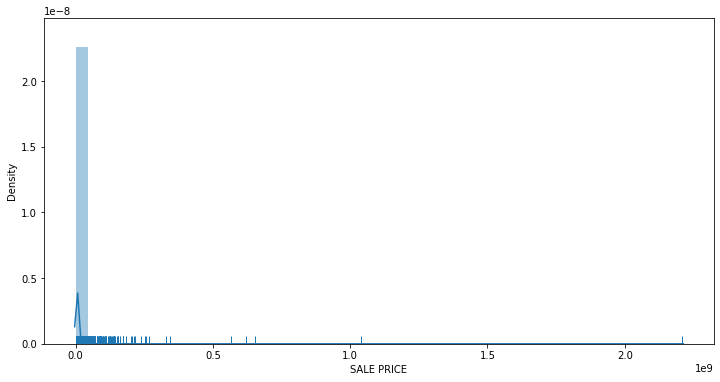

In [15]:
plt.figure(figsize=(12,6))
sns.distplot(df['SALE PRICE'], kde=True, bins=50, rug=True)
plt.show()

From the distribution above, there are a lot of outliners around 2000000 and above. At the same time, the majority of the values are close to 0. The most optimal place to is between 3.000.000 and 0.

In [16]:
df[(df['SALE PRICE'] < 10000) | (df['SALE PRICE'] > 3000000)]['SALE PRICE'].count() /len(df) 

0.22136712793808797

This shows that 22% of the values are either greater than 3.000.000 or less than 10.000. We remove this to get a better distribution of 'SALE PRICE'

In [17]:
df= df[(df['SALE PRICE'] > 10000) & (df['SALE PRICE']<3000000)]

In [18]:
df['SALE PRICE'].value_counts().head(10)

450000.0    426
550000.0    416
650000.0    413
600000.0    409
700000.0    382
400000.0    377
750000.0    376
500000.0    350
300000.0    348
350000.0    341
Name: SALE PRICE, dtype: int64

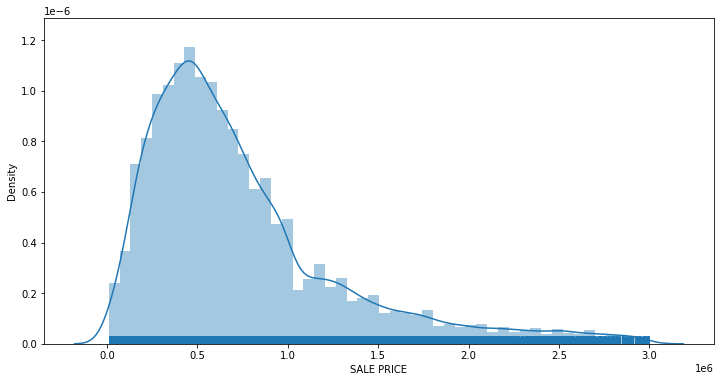

In [19]:
plt.figure(figsize=(12,6))
sns.distplot(df['SALE PRICE'], kde=True, bins=50, rug=True)
plt.show()

**The 'SALE PRICE' feature, our target feature, is now more appropriated distributed for our models.**

## Cleaning Square Feet

There are a lot of missing values in these features.
We can either fill them up with the mean average or remove them like this:

For the time being, lets remove this missing features

In [20]:
df = df.dropna(subset=['LAND SQUARE FEET'])
df = df.dropna(subset=['GROSS SQUARE FEET'])

Converting the features to a more appropriate type

In [21]:
df['LAND SQUARE FEET'] = df['LAND SQUARE FEET'].astype(float)
df['GROSS SQUARE FEET'] = df['GROSS SQUARE FEET'].astype(float)

In [22]:
df['LAND SQUARE FEET'].value_counts().head(10)

0.0       7854
2000.0    2303
2500.0    2028
4000.0    1820
1800.0     754
3000.0     734
5000.0     549
2400.0     327
1900.0     303
6000.0     271
Name: LAND SQUARE FEET, dtype: int64

In [23]:
df['GROSS SQUARE FEET'].value_counts().head(10)

0.0       8256
1800.0     242
1600.0     235
1440.0     232
2400.0     229
2000.0     221
1200.0     200
1280.0     188
3000.0     173
1224.0     164
Name: GROSS SQUARE FEET, dtype: int64

There are a lot of 0 values here, and means that the properties in this category has no square feet. we will remove these

In [24]:
df = df[df['LAND SQUARE FEET'] > 10]

In [25]:
df = df[df['GROSS SQUARE FEET'] > 10]

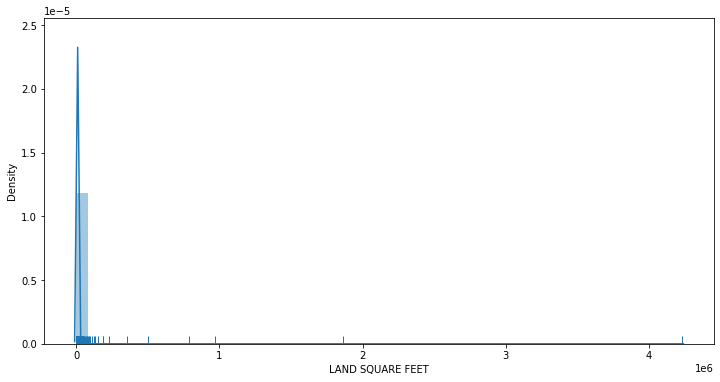

In [26]:
plt.figure(figsize=(12,6))
sns.distplot(df['LAND SQUARE FEET'], kde=True, bins=50, rug=True)
plt.show()

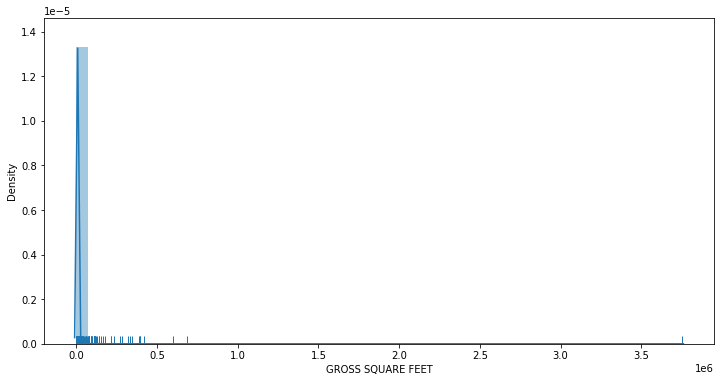

In [27]:
plt.figure(figsize=(12,6))
sns.distplot(df['GROSS SQUARE FEET'], kde=True, bins=50, rug=True)
plt.show()

As it is possible to see from the diagrams and value_counts(), there are a lot of outliners in these features. 
These can be cleaned by just reducing the number of values.

In [28]:
df = df[df['LAND SQUARE FEET'] < 20000]

In [29]:
df = df[df['GROSS SQUARE FEET'] < 20000]

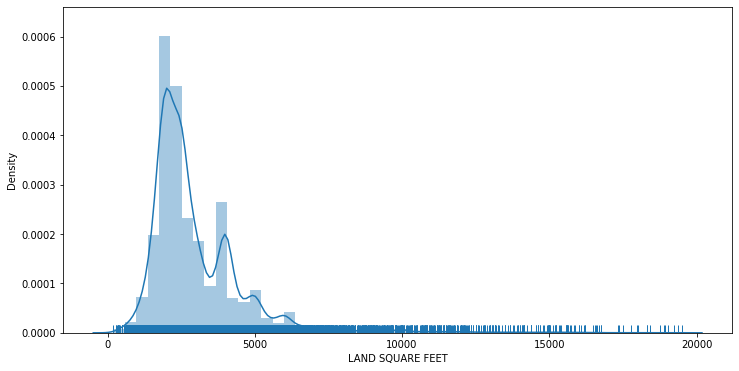

In [30]:
plt.figure(figsize=(12,6))
sns.distplot(df['LAND SQUARE FEET'], kde=True, bins=50, rug=True)
plt.show()

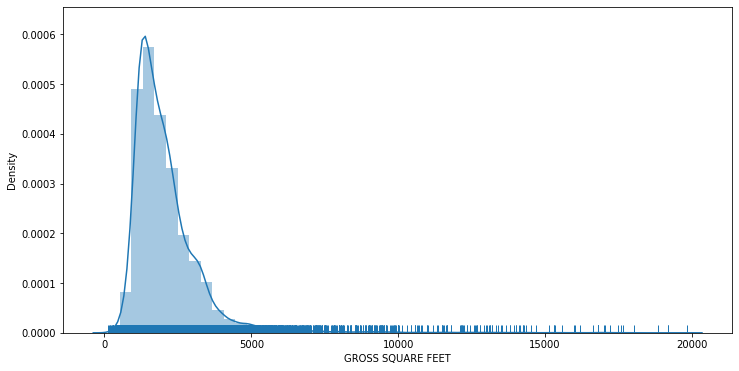

In [31]:
plt.figure(figsize=(12,6))
sns.distplot(df['GROSS SQUARE FEET'], kde=True, bins=50, rug=True)
plt.show()

## Cleaning Sale Date

TimeStamp types are hard to work with. Therefore, we make the 'SALE DATE' feature to two distinct features 'YEAR SOLD' and
'MONTH SOLD'. These two features can help us later in further analysis of the data

In [32]:
df['SALE DATE'].value_counts().head()

2017-04-28 00:00:00    183
2016-09-30 00:00:00    175
2017-02-28 00:00:00    173
2016-12-22 00:00:00    171
2016-10-28 00:00:00    169
Name: SALE DATE, dtype: int64

Making a list with alle the different months 

In [33]:
months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

Spliting Sale Date into to features, one for Month Sold and one for Year Sold. This is first for making a TimeStamp feature easier to use, and for calculating which month or year had the highest sales rate

In [34]:
df['YEAR SOLD'] = [int(n[0:4]) for n in df['SALE DATE']]
df['MONTH SOLD'] = [int(n[5:7]) for n in df['SALE DATE']]
df = df.drop(['SALE DATE'], axis=1)

Text(0.5, 1.0, 'Number of properties sold by year')

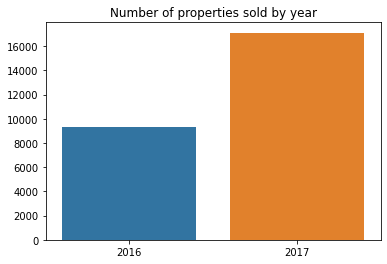

In [35]:
plt.hist(df['YEAR SOLD'], bins=2, color='c')
counts_per_year = [sum(df['YEAR SOLD'] == 2016), sum(df['YEAR SOLD'] == 2017)]
sns.barplot([2016, 2017], counts_per_year).set_title('Number of properties sold by year')

The first diagram shows that there were significant more houses sold in 2017 than in 2016, showing an increase that may indicate an even bigger increase in a predictive model for 2018

Code retrieved from: https://jshams.github.io/NYC-real-estate-analysis/new_york_real_estate.slides.html#/5/2 and https://jshams.github.io/NYC-real-estate-analysis/new_york_real_estate.slides.html#/6/2

Transforming to more appriopriate types

In [36]:
df['MONTH SOLD'] = df['MONTH SOLD'].astype('category')

In [37]:
df['YEAR SOLD'] = df['YEAR SOLD'].astype('category')

## Cleaning Tax Class

Dropping all the NaN values

In [38]:
df = df.dropna(subset=['TAX CLASS AT PRESENT'])

In [39]:
df['TAX CLASS AT TIME OF SALE'].value_counts()

1    24242
2     1435
4      764
Name: TAX CLASS AT TIME OF SALE, dtype: int64

In [40]:
df['TAX CLASS AT PRESENT'].value_counts()

1     24245
2A     1113
4       763
2B      236
2        83
2C        1
Name: TAX CLASS AT PRESENT, dtype: int64

Tax classes, as mentioned earlier, should be categorical classes. Therefore, it is more appropriate to replace the values to more informative values as shown below

In [41]:
df['TAX CLASS AT TIME OF SALE'] = df['TAX CLASS AT TIME OF SALE'].replace({1:'Class_1',
                                                                           2:'Class_2',
                                                                           4:'Class_4'})

In [42]:
df['TAX CLASS AT PRESENT'] = df['TAX CLASS AT PRESENT'].replace({'1':'Class_1',
                                                                 '1A':'Class_1',
                                                                 '1B':'Class_1',
                                                                 '1C':'Class_1',
                                                                 '2':'Class_2',
                                                                 '2A':'Class_2',
                                                                 '2B':'Class_2',
                                                                 '2C':'Class_2',
                                                                 '3':'Class_3',
                                                                 '4':'Class_4'})

Converting the features to more appropiate types

In [43]:
df['TAX CLASS AT TIME OF SALE'] = df['TAX CLASS AT TIME OF SALE'].astype('category')
df['TAX CLASS AT PRESENT'] = df['TAX CLASS AT PRESENT'].astype('category')

<AxesSubplot:ylabel='TAX CLASS AT PRESENT'>

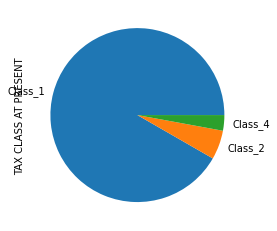

In [44]:
df['TAX CLASS AT PRESENT'].value_counts().plot(kind='pie')

<AxesSubplot:ylabel='TAX CLASS AT TIME OF SALE'>

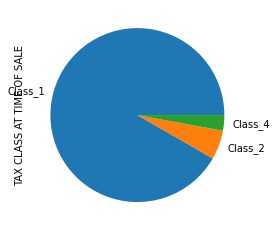

In [45]:
df['TAX CLASS AT TIME OF SALE'].value_counts().plot(kind='pie')

**These pie charts show that more the 3/4 of all the values in the features belong to class_1.** 

- Class 1: Includes most residential property of up to three units (such as one-, two-, and three-family homes and small stores   or offices with one or two attached apartments), vacant land that is zoned for residential use, and most condominiums that     are not more than three stories.
- Class 2: Includes all other property that is primarily residential, such as cooperatives and condominiums.
- Class 4: Includes all other properties not included in class 1,2, and 3, such as offices, factories, warehouses, garage         buildings, etc. 

**We have chosen to not remove class_2 and class_4 because we want to focus on all of the properties instead of only focusing on residential properties.**

## Cleaning Buliding Class

Converting the features to more appropiate types

In [46]:
df['BUILDING CLASS AT TIME OF SALE'] = df['BUILDING CLASS AT TIME OF SALE'].astype('category')

'BUILDING CLASS AT TIME OF SALE' and 'BUILDING CLASS CATEGORY' is significant the same. We remove one of them to prevent having to many features.

In [47]:
df = df.drop(['BUILDING CLASS AT PRESENT'], axis=1)

In [48]:
df['BUILDING CLASS CATEGORY'].value_counts()

01 ONE FAMILY DWELLINGS                        12390
02 TWO FAMILY DWELLINGS                         9590
03 THREE FAMILY DWELLINGS                       2239
07 RENTALS - WALKUP APARTMENTS                  1177
22 STORE BUILDINGS                               310
14 RENTALS - 4-10 UNIT                           253
29 COMMERCIAL GARAGES                            111
21 OFFICE BUILDINGS                              107
30 WAREHOUSES                                     94
27 FACTORIES                                      51
37 RELIGIOUS FACILITIES                           43
05 TAX CLASS 1 VACANT LAND                        12
33 EDUCATIONAL FACILITIES                         12
06 TAX CLASS 1 - OTHER                            11
41 TAX CLASS 4 - OTHER                             9
35 INDOOR PUBLIC AND CULTURAL FACILITIES           9
32 HOSPITAL AND HEALTH FACILITIES                  7
38 ASYLUMS AND HOMES                               5
26 OTHER HOTELS                               

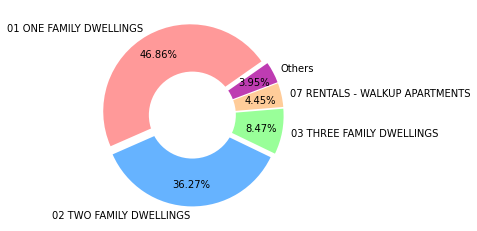

In [49]:
property_types = {'01 ONE FAMILY DWELLINGS': 12390,
 '02 TWO FAMILY DWELLINGS': 9590,
 '03 THREE FAMILY DWELLINGS': 2239,
 '07 RENTALS - WALKUP APARTMENTS': 1177,
 'Others' : 1045}                         # 'Others' here is the sum of fifth - 28th value given above

labels = property_types.keys()
sizes = property_types.values()
colors = ['#ff9999','#66b3ff','#99ff99','#ffcc99', '#be3cb2']
plt.pie(sizes, colors = colors, labels=labels, autopct='%1.2f%%',startangle=35, pctdistance=0.75, explode = tuple([0.05] * 5))
centre_circle = plt.Circle((0,0),0.50,fc='#ffffff')
plt.gcf().gca().add_artist(centre_circle)

From the value_count() and Pie Chart above, we can observe that the first four values stands out the most and the rest should rather be one value to remove a lot of outliners. This is because the others value is a lower percentage than the fourth value. Code retrieved from: https://jshams.github.io/NYC-real-estate-analysis/new_york_real_estate.slides.html#/8

We tried to make a new feature called others with the fifth all the way down to the 20th value, but it seems it is not possible to combine all of them. Either way, we chose to keep the feature anyway. 

Converting to a more appropriate feature

In [50]:
df['BUILDING CLASS CATEGORY'] = df['BUILDING CLASS CATEGORY'].astype('category')

## Cleaning Borough

Change borough index to borough real name in New York City

In [51]:
df['BOROUGH'][df['BOROUGH'] == 1] = 'Manhattan'
df['BOROUGH'][df['BOROUGH'] == 2] = 'Bronx'
df['BOROUGH'][df['BOROUGH'] == 3] = 'Brooklyn'
df['BOROUGH'][df['BOROUGH'] == 4] = 'Queens'
df['BOROUGH'][df['BOROUGH'] == 5] = 'Staten Island'

Converting 'BOROUGH' to a more appropriate types

In [52]:
df['BOROUGH'] = df['BOROUGH'].astype('category')

Text(0.5, 1.0, 'Sales per Borough')

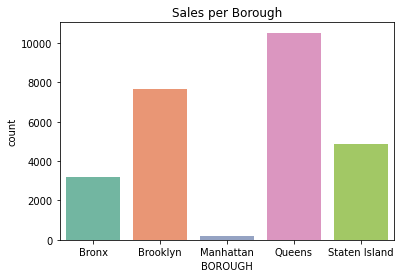

In [53]:
sns.countplot('BOROUGH',data=df,palette='Set2')
plt.title('Sales per Borough')

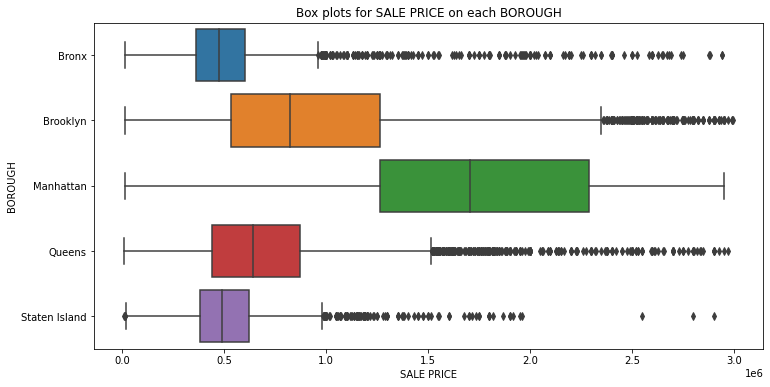

In [54]:
plt.figure(figsize=(12,6))
sns.boxplot(y = 'BOROUGH', x = 'SALE PRICE', data = df )
plt.title('Box plots for SALE PRICE on each BOROUGH')
plt.show()

These diagrams above shows a how big difference of property sold and outliners there exists in this features.

## Cleaning Year Built

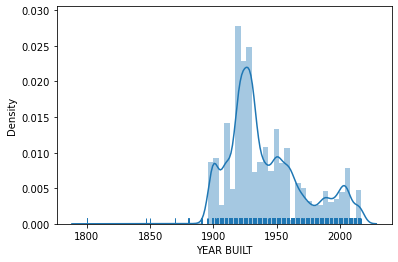

In [55]:
df=df[df['YEAR BUILT']!=0]
sns.distplot(df['YEAR BUILT'], bins=50, rug=True)
plt.show()

**As its possible to se from the graph above, the feature will work best if the values from 1800 - 1900 are removed. With this, we removed some of the possible outliners in our model.**

In [56]:
df= df[(df['YEAR BUILT'] > 1880)]

Converting the feature to a more appropriate type

In [57]:
df['YEAR BUILT'] = df['YEAR BUILT'].astype('category')

## Cleaning "... Units"

Dropping 'TOTAL UNITS' because its only the sum of 'RESIDENTIAL UNITS' and 'COMMERCIAL UNITS'

In [58]:
df = df.drop(['TOTAL UNITS'], axis=1)

<AxesSubplot:xlabel='RESIDENTIAL UNITS', ylabel='count'>

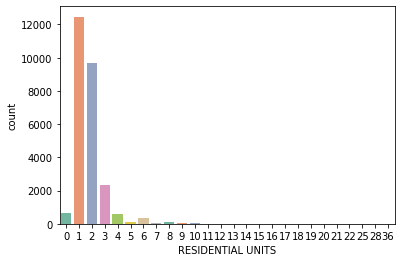

In [59]:
sns.countplot('RESIDENTIAL UNITS',data=df,palette='Set2')

<AxesSubplot:xlabel='COMMERCIAL UNITS', ylabel='count'>

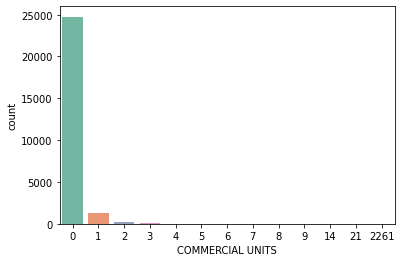

In [60]:
sns.countplot('COMMERCIAL UNITS',data=df,palette='Set2')

In [61]:
df= df[(df['RESIDENTIAL UNITS'] < 10)]

In [62]:
df= df[(df['COMMERCIAL UNITS'] < 7)]

**The 'Units' features have a really skewed distribution. To avoid to many outliners, We only include the values with the most counts**

## Cleaning Neighborhood

Converting the feature to a more appropriate type

In [63]:
df['NEIGHBORHOOD'] = df['NEIGHBORHOOD'].astype('category')

# Overview so far

In [64]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 26309 entries, 222 to 84547
Data columns (total 14 columns):
 #   Column                          Non-Null Count  Dtype   
---  ------                          --------------  -----   
 0   BOROUGH                         26309 non-null  category
 1   NEIGHBORHOOD                    26309 non-null  category
 2   BUILDING CLASS CATEGORY         26309 non-null  category
 3   TAX CLASS AT PRESENT            26309 non-null  category
 4   RESIDENTIAL UNITS               26309 non-null  int64   
 5   COMMERCIAL UNITS                26309 non-null  int64   
 6   LAND SQUARE FEET                26309 non-null  float64 
 7   GROSS SQUARE FEET               26309 non-null  float64 
 8   YEAR BUILT                      26309 non-null  category
 9   TAX CLASS AT TIME OF SALE       26309 non-null  category
 10  BUILDING CLASS AT TIME OF SALE  26309 non-null  category
 11  SALE PRICE                      26309 non-null  float64 
 12  YEAR SOLD       

**By now, all the necessary features have been cleaned from most of outliners and converted to the preferred types needed for the algorithms.**

# Data Pre-Processing - Making Categorical Data more Appropriate

**Since most of our models prefer continous features, and our dataset contains an significant amount categorical data, we have to encode our categorical data so we can actually use the features in our models. For this we will use One-Hot-Encoding and Label Encoding, depending on how many unique values there exists in the features.** 

In [65]:
df['BOROUGH'].unique()

['Manhattan', 'Bronx', 'Brooklyn', 'Queens', 'Staten Island']
Categories (5, object): ['Manhattan', 'Bronx', 'Brooklyn', 'Queens', 'Staten Island']

In [66]:
df['TAX CLASS AT PRESENT'].unique()

['Class_2', 'Class_4', 'Class_1']
Categories (3, object): ['Class_2', 'Class_4', 'Class_1']

In [67]:
df['TAX CLASS AT TIME OF SALE'].unique()

['Class_2', 'Class_4', 'Class_1']
Categories (3, object): ['Class_2', 'Class_4', 'Class_1']

In [68]:
df['BUILDING CLASS CATEGORY'].unique()

['07 RENTALS - WALKUP APARTMENTS             ', '22 STORE BUILDINGS                         ', '01 ONE FAMILY DWELLINGS                    ', '02 TWO FAMILY DWELLINGS                    ', '03 THREE FAMILY DWELLINGS                  ', ..., '33 EDUCATIONAL FACILITIES                  ', '38 ASYLUMS AND HOMES                       ', '31 COMMERCIAL VACANT LAND                  ', '35 INDOOR PUBLIC AND CULTURAL FACILITIES   ', '08 RENTALS - ELEVATOR APARTMENTS           ']
Length: 22
Categories (22, object): ['07 RENTALS - WALKUP APARTMENTS             ', '22 STORE BUILDINGS                         ', '01 ONE FAMILY DWELLINGS                    ', '02 TWO FAMILY DWELLINGS                    ', ..., '38 ASYLUMS AND HOMES                       ', '31 COMMERCIAL VACANT LAND                  ', '35 INDOOR PUBLIC AND CULTURAL FACILITIES   ', '08 RENTALS - ELEVATOR APARTMENTS           ']

In [69]:
df['YEAR SOLD'].unique()

[2017, 2016]
Categories (2, int64): [2017, 2016]

**These categorical features above have few unique values which makes One-Hot-Encoding the most appropriate way to make the features continious**

**We make a list of all these features for an easier overview**

In [70]:
one_hot_features = ['BOROUGH', 'TAX CLASS AT PRESENT', 'TAX CLASS AT TIME OF SALE', 'BUILDING CLASS CATEGORY', 'YEAR SOLD']

In [71]:
one_hot_encoded = pd.get_dummies(df[one_hot_features])

df = df.drop(one_hot_features, axis = 1)

df = pd.concat([df, one_hot_encoded], axis=1)

**The rest of the categorical features are a little bit different. There are hundres of unique features which makes Label Encoding more appropriate than One-Hot_encoding. This is for preventing a higher dimensionality and ending up with many more features necassary.**

In [72]:
df['NEIGHBORHOOD'].unique()

['CHELSEA', 'CHINATOWN', 'GREENWICH VILLAGE-WEST', 'HARLEM-CENTRAL', 'HARLEM-EAST', ..., 'TRAVIS', 'WEST NEW BRIGHTON', 'WESTERLEIGH', 'WILLOWBROOK', 'WOODROW']
Length: 226
Categories (226, object): ['CHELSEA', 'CHINATOWN', 'GREENWICH VILLAGE-WEST', 'HARLEM-CENTRAL', ..., 'WEST NEW BRIGHTON', 'WESTERLEIGH', 'WILLOWBROOK', 'WOODROW']

In [73]:
label_encoder = LabelEncoder()

df['NEIGHBORHOOD'] = label_encoder.fit_transform(df['NEIGHBORHOOD'])

In [74]:
df['BUILDING CLASS AT TIME OF SALE'].unique()

['C4', 'K4', 'A5', 'C2', 'A4', ..., 'GU', 'W8', 'H8', 'Z0', 'M3']
Length: 82
Categories (82, object): ['C4', 'K4', 'A5', 'C2', ..., 'W8', 'H8', 'Z0', 'M3']

In [75]:
label_encoder_2 = LabelEncoder()

df['BUILDING CLASS AT TIME OF SALE'] = label_encoder_2.fit_transform(df['BUILDING CLASS AT TIME OF SALE'])

In [76]:
df['YEAR BUILT'].unique()

[1901, 1915, 1900, 1910, 1899, ..., 1978, 1891, 1881, 1943, 2017]
Length: 123
Categories (123, int64): [1901, 1915, 1900, 1910, ..., 1891, 1881, 1943, 2017]

In [77]:
label_encoder_3 = LabelEncoder()

df['YEAR BUILT'] = label_encoder_3.fit_transform(df['YEAR BUILT'])

In [78]:
df['MONTH SOLD'].unique()

[8, 1, 10, 5, 11, ..., 9, 2, 6, 12, 4]
Length: 12
Categories (12, int64): [8, 1, 10, 5, ..., 2, 6, 12, 4]

In [79]:
label_encoder_4 = LabelEncoder()

df['MONTH SOLD'] = label_encoder_4.fit_transform(df['MONTH SOLD'])

# K-means Unsupervised Learning

**To imporve the overall performance of the models, we decided to use k-means method to make clusters to see if there exists any logical ways to group the data in a feature space**

We start by just making a scattermap overview with all the features.

scatter_df = df.drop(['SALE PRICE'], axis = 1)

for col in scatter_df.columns: 
    plt.scatter(scatter_df[col], df['SALE PRICE']) 
    plt.ylabel('Sale price') 
    plt.xlabel(col) 
    plt.show()

As the scattermaps shows above, the different features are scattered very different from each other because of the categorical features. The continous features show a vide fully scattered maps and the categorical features are scattered like lines. This will affect our k-means cluster model. 

Since we are using k-means clustering, we need to define a k. k is defined as how many clusters we want in our unsupervised model. Thats why we use the elbow method to get the most optimal k.

The code used below for our Unsupervised Learning Model is retrieved from: https://predictivehacks.com/k-means-elbow-method-code-for-python/

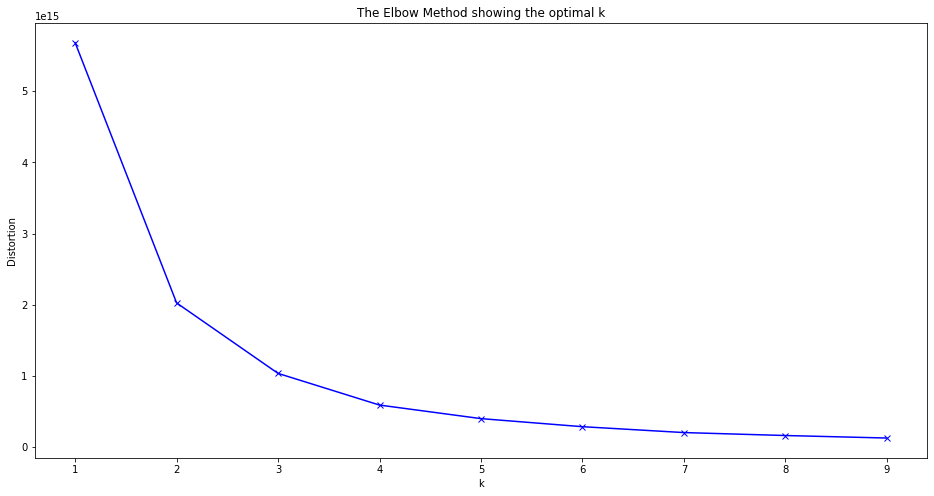

In [80]:
distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k)
    kmeanModel.fit(df)
    distortions.append(kmeanModel.inertia_)

plt.figure(figsize=(16,8))
plt.plot(K, distortions, 'bx-') 
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

**The model above shows us that the most optimal k is two. We only need two clusters**

Text(0.5, 1.0, 'K_Means')

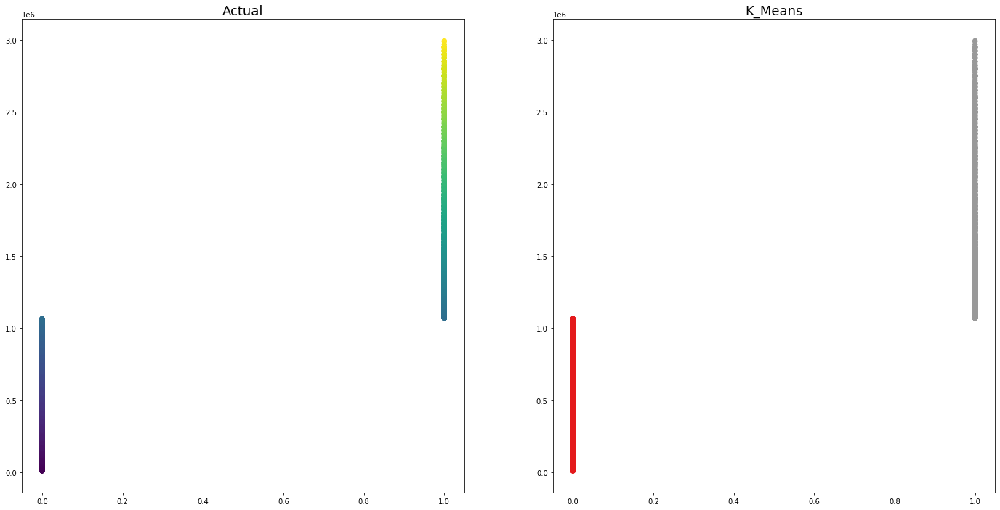

In [81]:
kmeanModel = KMeans(n_clusters=2)
kmeanModel.fit(df)

df['k_means'] = kmeanModel.predict(df)
df['SALE PRICE'] = df['SALE PRICE']

fig, axes = plt.subplots(1, 2, figsize=(24,12))
axes[0].scatter(df['k_means'], df['SALE PRICE'], c=df['SALE PRICE'])
axes[1].scatter(df['k_means'], df['SALE PRICE'], c=df['k_means'], cmap=plt.cm.Set1)
axes[0].set_title('Actual', fontsize=18)
axes[1].set_title('K_Means', fontsize=18)

**As the models above show, the k-means clustering result is questionable. They show us two straigth lines in two very different intervals and does not really tell us much about how the groupings of the different features are. This might be because of the high complexity of our data or because of the how the categorical features are placed in a feature space, as the scatter maps above shows.**

**However, as we have seen in different tests of the machine learning models, the visualization of the Unsupervised Learning Model might not be good at all, but the models perform way better with the k-means feature than without. This means that the k-means clustering is of value and there actually are groupings of the features in a feature space.**

In [82]:
minmax_df = df.copy()

In [83]:
minmax_df_columns = minmax_df.columns
minmax_scaler = MinMaxScaler()
minmax_df = minmax_scaler.fit_transform(minmax_df)

minmax_df = pd.DataFrame(minmax_df)
minmax_df.columns = minmax_df_columns

minmax_df.head(10)

,NEIGHBORHOOD,RESIDENTIAL UNITS,COMMERCIAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,BUILDING CLASS AT TIME OF SALE,SALE PRICE,MONTH SOLD,BOROUGH_Bronx,...,BUILDING CLASS CATEGORY_31 COMMERCIAL VACANT LAND,BUILDING CLASS CATEGORY_32 HOSPITAL AND HEALTH FACILITIES,BUILDING CLASS CATEGORY_33 EDUCATIONAL FACILITIES,BUILDING CLASS CATEGORY_35 INDOOR PUBLIC AND CULTURAL FACILITIES,BUILDING CLASS CATEGORY_37 RELIGIOUS FACILITIES,BUILDING CLASS CATEGORY_38 ASYLUMS AND HOMES,BUILDING CLASS CATEGORY_41 TAX CLASS 4 - OTHER,YEAR SOLD_2016,YEAR SOLD_2017,k_means
0,0.164444,1.000000,0.000000,0.070777,0.325472,0.057377,0.209877,0.527249,0.636364,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0
1,0.164444,1.000000,0.000000,0.070777,0.325472,0.057377,0.209877,0.136278,0.636364,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
2,0.164444,1.000000,0.000000,0.070777,0.325472,0.057377,0.209877,0.207829,0.636364,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
3,0.168889,0.000000,0.333333,0.046528,0.135849,0.163934,0.567901,0.901172,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0
4,0.417778,0.111111,0.000000,0.009534,0.054088,0.057377,0.061728,0.457286,0.818182,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
5,0.417778,0.555556,0.000000,0.102124,0.178407,0.049180,0.185185,0.101507,0.363636,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
6,0.431111,0.111111,0.000000,0.069896,0.152830,0.122951,0.049383,0.767169,0.909091,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
7,0.431111,0.111111,0.000000,0.075907,0.161426,0.122951,0.098765,0.502512,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0
8,0.431111,0.111111,0.000000,0.077668,0.179036,0.057377,0.098765,0.531253,0.636364,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0
9,0.431111,0.111111,0.000000,0.066736,0.200786,0.040984,0.098765,0.733668,0.181818,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0


In [84]:
standard_df = df.copy()

To be able to make the most accurate models possible, we should use Principal Component Ananlysis (PCA). To do this, we have to use a Standard Scaler 

In [85]:
standard_df_columns = standard_df.columns
scaler = StandardScaler()
standard_df = scaler.fit_transform(standard_df)

standard_df = pd.DataFrame(standard_df)
standard_df.columns = standard_df_columns

standard_df.head(10)

,NEIGHBORHOOD,RESIDENTIAL UNITS,COMMERCIAL UNITS,LAND SQUARE FEET,GROSS SQUARE FEET,YEAR BUILT,BUILDING CLASS AT TIME OF SALE,SALE PRICE,MONTH SOLD,BOROUGH_Bronx,...,BUILDING CLASS CATEGORY_31 COMMERCIAL VACANT LAND,BUILDING CLASS CATEGORY_32 HOSPITAL AND HEALTH FACILITIES,BUILDING CLASS CATEGORY_33 EDUCATIONAL FACILITIES,BUILDING CLASS CATEGORY_35 INDOOR PUBLIC AND CULTURAL FACILITIES,BUILDING CLASS CATEGORY_37 RELIGIOUS FACILITIES,BUILDING CLASS CATEGORY_38 ASYLUMS AND HOMES,BUILDING CLASS CATEGORY_41 TAX CLASS 4 - OTHER,YEAR SOLD_2016,YEAR SOLD_2017,k_means
0,-1.094576,6.844446,-0.219619,-0.834112,3.711228,-1.316504,0.506661,1.850762,0.407264,-0.369269,...,-0.006165,-0.016314,-0.020452,-0.018499,-0.040461,-0.010679,-0.01744,-0.739500,0.739500,2.280155
1,-1.094576,6.844446,-0.219619,-0.834112,3.711228,-1.316504,0.506661,-0.660989,0.407264,-0.369269,...,-0.006165,-0.016314,-0.020452,-0.018499,-0.040461,-0.010679,-0.01744,-0.739500,0.739500,-0.438567
2,-1.094576,6.844446,-0.219619,-0.834112,3.711228,-1.316504,0.506661,-0.201317,0.407264,-0.369269,...,-0.006165,-0.016314,-0.020452,-0.018499,-0.040461,-0.010679,-0.01744,-0.739500,0.739500,-0.438567
3,-1.079598,-1.609128,5.088554,-1.102038,0.566702,-0.883484,2.682397,4.252987,-1.607103,-0.369269,...,-0.006165,-0.016314,-0.020452,-0.018499,-0.040461,-0.010679,-0.01744,-0.739500,0.739500,2.280155
4,-0.240809,-0.669842,-0.219619,-1.510798,-0.789146,-1.316504,-0.393643,1.401292,0.982797,-0.369269,...,-0.006165,-0.016314,-0.020452,-0.018499,-0.040461,-0.010679,-0.01744,1.352265,-1.352265,2.280155
5,-0.240809,3.087302,-0.219619,-0.487754,1.272439,-1.349813,0.356611,-0.884368,-0.456036,-0.369269,...,-0.006165,-0.016314,-0.020452,-0.018499,-0.040461,-0.010679,-0.01744,-0.739500,0.739500,-0.438567
6,-0.195873,-0.669842,-0.219619,-0.843844,0.848301,-1.050030,-0.468668,3.392098,1.270564,-0.369269,...,-0.006165,-0.016314,-0.020452,-0.018499,-0.040461,-0.010679,-0.01744,1.352265,-1.352265,2.280155
7,-0.195873,-0.669842,-0.219619,-0.777435,0.990839,-1.050030,-0.168567,1.691842,-1.607103,-0.369269,...,-0.006165,-0.016314,-0.020452,-0.018499,-0.040461,-0.010679,-0.01744,-0.739500,0.739500,2.280155
8,-0.195873,-0.669842,-0.219619,-0.757970,1.282868,-1.316504,-0.168567,1.876481,0.407264,-0.369269,...,-0.006165,-0.016314,-0.020452,-0.018499,-0.040461,-0.010679,-0.01744,-0.739500,0.739500,2.280155
9,-0.195873,-0.669842,-0.219619,-0.878766,1.643559,-1.383122,-0.168567,3.176875,-1.031570,-0.369269,...,-0.006165,-0.016314,-0.020452,-0.018499,-0.040461,-0.010679,-0.01744,-0.739500,0.739500,2.280155


**Now that we have used our data in the Unsupervised Model and defined our necessary scaling methods, we are now ready to create our Machine Learning Models.**

# ---------------------------------- NYC SALES PREDICTION -----------------------------------------

**Before we run every Model, we will perform a Grid Search to see what the best parameters for each model is**

## Tree Models

Since these Tree Models don't need any scaling, we have chosen to not use any because of the scores without scaling are better.

We still need to split the data set in a train_test_split

In [86]:
y = df['SALE PRICE']
x = df.drop(['SALE PRICE'], axis = 1)

x_train, x_test , y_train, y_test = train_test_split(x , y, random_state = 1)

In [87]:
#dt = DecisionTreeRegressor().fit(x_train, y_train)

#param_grid = {'max_depth' : [1,5,10,15,20,50,100]}
#grid_dt = GridSearchCV(DecisionTreeRegressor() , param_grid = param_grid)
#grid_dt.fit(x_train , y_train)

#print('Grid search with the best accuracy: \n------------------------------------')
#print('Best parameters: ', grid_dt.best_params_) 
#print('Best cross validation score(Accuracy): {:.3f}'.format(grid_dt.best_score_))

#print('Test set score: {:.3f}'.format(grid_dt.score(x_test,y_test)))

The GridSearch above gave us the paramter 'max_depth: 10'

In [88]:
dt = DecisionTreeRegressor(max_depth=10).fit(x_train, y_train)

print("Decision Tree Classifier Model")
print("------------------------------")
print()
print("Training set score: {:.5f}".format(dt.score(x_train, y_train)))
print("Test set score: {:.5f}".format(dt.score(x_test, y_test)))

Decision Tree Classifier Model
------------------------------

Training set score: 0.81575
Test set score: 0.72704


In [89]:
#rf = RandomForestRegressor().fit(x_train, y_train)

#param_grid = {'max_depth' : [1,5,10,15,20,50,100]}
#grid_rf = GridSearchCV(RandomForestRegressor() , param_grid = param_grid)
#grid_rf.fit(x_train , y_train)

#print('Grid search with the best accuracy: \n------------------------------------')
#print('Best parameters: ', grid_rf.best_params_) 
#print('Best cross validation score(Accuracy): {:.3f}'.format(grid_rf.best_score_))

#print('Test set score: {:.3f}'.format(grid_rf.score(x_test,y_test)))

The GridSearch above gave us the paramter 'max_depth: 10'

In [90]:
rf = RandomForestRegressor(max_depth=10).fit(x_train, y_train)

print("Random Forest Regressor Model")
print("-----------------------------")
print()
print("Training set score: {:.5f}".format(rf.score(x_train, y_train)))
print("Test set score: {:.5f}".format(rf.score(x_test, y_test)))

Random Forest Regressor Model
-----------------------------

Training set score: 0.83575
Test set score: 0.76842


In [91]:
#gbr = GradientBoostingRegressor(n_estimators = 500)
#param_grid = {'learning_rate' : [0.0001,0.001,0.01,1,0.05,0.1, 0.15, 0.5]}
#grid_gbr = GridSearchCV(gbr , param_grid , n_jobs = -1)
#grid_gbr.fit(x_train , y_train)

#print('Grid search with the best accuracy:')
#print('-----------------------------------')
#print('Best parameters: ', grid_gbr.best_params_) 
#print('Best cross validation score(Accuracy): {:.5f}'.format(grid_gbr.best_score_))

The GridSearch above gave us the paramter 'learning_rate: 0.15'

In [92]:
gbr = GradientBoostingRegressor(n_estimators = 500, learning_rate=0.15)
gbr.fit(x_train, y_train)

print("Gradient Boosting Regressor Model")
print("---------------------------------")
print()
print("Training set score: {:.5f}".format(gbr.score(x_train, y_train)))
print("Test set score: {:.5f}".format(gbr.score(x_test, y_test)))

Gradient Boosting Regressor Model
---------------------------------

Training set score: 0.82776
Test set score: 0.77408


**These Tree Models aboves gives extremely good scores. Its no suprise that the Random Forest Model has a higher score than the Decision Tree Model, and the Gradient Booster Regressor has a higher score than the Random Forest Model. Random Forest has 'more brances' than the Decision Tree Model and gives better possiblities for the model to choose, while the Gradient Boosting Regressor is able to find the most suited 'branch' out of all the 'branches' and therefore has the best score.**

## Linear Regression

In [93]:
y = standard_df['SALE PRICE']
x = standard_df.drop(['SALE PRICE'], axis = 1)

print("The shape of the target set:", y.shape)
print("The shape of the dataset:", x.shape)

x_train, x_test , y_train, y_test = train_test_split(x , y, random_state = 1)

The shape of the target set: (26309,)
The shape of the dataset: (26309, 46)


In [94]:
lr = LinearRegression().fit(x_train , y_train)

print("Normal Linear Regression Model")
print("------------------------------")
print()
print("Training set score: {:.5f}".format(lr.score(x_train, y_train)))
print("Test set score: {:.5f}".format(lr.score(x_test, y_test)))

Normal Linear Regression Model
------------------------------

Training set score: 0.69277
Test set score: -241610436170750304.00000


In [95]:
#ridge = Ridge().fit(x_train, y_train)

#alpha = [0.001, 0.01, 0.1, 1, 10, 100, 1000]
#param_grid = dict(alpha=alpha)

#grid = GridSearchCV(estimator=ridge, param_grid=param_grid, scoring='r2')
#grid_result = grid.fit(x_train, y_train)

#print('Best Score: ', grid_result.best_score_)
#print('Best Params: ', grid_result.best_params_)

The GridSearch above gave us the paramter 'alpha: 1'

In [96]:
ridge = Ridge(alpha=100).fit(x_train, y_train)

print("Ridge Regression Model")
print("----------------------")
print()
print("Training set score: {:.5f}".format(ridge.score(x_train, y_train)))
print("Test set score: {:.5f}".format(ridge.score(x_test, y_test)))

Ridge Regression Model
----------------------

Training set score: 0.69260
Test set score: 0.69021


In [97]:
#lasso = Lasso().fit(x_train, y_train)

#alpha = [0.001, 0.01, 0.1, 1, 10, 100, 1000]
#param_grid = dict(alpha=alpha)

#grid = GridSearchCV(estimator=lasso, param_grid=param_grid, scoring='r2')
#grid_result = grid.fit(x_train, y_train)

#print('Best Score: ', grid_result.best_score_)
#print('Best Params: ', grid_result.best_params_)

The GridSearch above gave us the paramter 'alpha: 0.001'

In [98]:
lasso = Lasso(alpha=0.01).fit(x_train, y_train)

print("Lasso Regression Model")
print("----------------------")
print()
print("Training set score: {:.5f}".format(lasso.score(x_train, y_train)))
print("Test set score: {:.5f}".format(lasso.score(x_test, y_test)))

Lasso Regression Model
----------------------

Training set score: 0.69044
Test set score: 0.68997


In [99]:
#nn = MLPRegressor()
#param_grid = {"hidden_layer_sizes": [(1,),(10,),(25),(50,),(60,),(70,),(80,),(90,)], 
#              "activation": ["identity", "logistic", "tanh", "relu"], 
#              "alpha": [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 1000]}
#grid_nn = GridSearchCV(nn, param_grid , n_jobs = -1)
#grid_nn.fit(x_train , y_train)

#print('Grid search with the best accuracy:')
#print('-----------------------------------')
#print('Best parameters: ', grid_nn.best_params_) 
#print('Best cross validation score(Accuracy): {:.5f}'.format(grid_nn.best_score_))

The GridSearch above gave us the paramter 'alpha: 0.01' and 'hidden_layers_sizes: (80,)'

In [100]:
nn = MLPRegressor(hidden_layer_sizes= [80,45], activation='relu', alpha=0.1)
nn.fit(x_train, y_train)

print("Neural Network Regressor Model")
print("------------------------------")
print()
print("Training set score: {:.5f}".format(nn.score(x_train, y_train)))
print("Test set score: {:.5f}".format(nn.score(x_test, y_test)))

Neural Network Regressor Model
------------------------------

Training set score: 0.78364
Test set score: 0.72779


**The Regressions above gives us a score that is overall not that bad. 
Linear Regression scores significantly bad, but that is expected because of the features are not linear and then the linear line from this model will not be able to make a straigth line.**

**Ridge and Lasso scores overall better than the linear because of the models being more appriopriate for complex data, and the grid search gives us the most optimal alpha.**

**Lastly, the Neural Network Model scores best. This is expected because of Neaural Network being the most suited for complex and big data. The reason being the parameter with hidden layers.**

## Gaussian and Bernoulli Naive Bayes

**This Machine Learning Models is a little bit different than the others. Since this Model is more about classification, we have to, as mentioned before, convert our target feature 'SALE PRICE' into a categorical type. Since the date pre-processing is different than the Models above, we have to do a new pre-processing. This will be based on the pre-processing we did before.** 

### Data Pre-Processing

In [101]:
catedf = df
catedf3 = catedf[(catedf['SALE PRICE'] >= 1400000)]
catedf2 = catedf[(catedf['SALE PRICE'] >= 850000) & (catedf['SALE PRICE'] < 1400000)]
catedf1 = catedf[(catedf['SALE PRICE'] >= 400000) & (catedf['SALE PRICE'] < 850000)]
catedf0 = catedf[(catedf['SALE PRICE'] < 400000)]
names_list = [catedf0, catedf1 , catedf2 , catedf3]
final_list = []
new_df = []
for i in range(4):
    numbers_list = [i]*len(names_list[i])

    catedf = names_list[i]
    catedf['CATEGORICAL PRICE'] = numbers_list
    new_df.append(catedf)
catedf = new_df[0].append([new_df[1],new_df[2],new_df[3]])
catedf = catedf.drop(['SALE PRICE'], axis = 1)

Dividing dataframe into one contaning the categorical variables, and one containing the continous. 
However some of the categorical data has not been categorized using one-hot-encoding. Therefore these variables are not binary, and can not be used for categorical NaiveBayes, will be dropped. 

In [102]:
categorical_df = catedf.drop(['GROSS SQUARE FEET' , 'LAND SQUARE FEET' , 'COMMERCIAL UNITS' , 'RESIDENTIAL UNITS', 'NEIGHBORHOOD' ,
                              'BUILDING CLASS AT TIME OF SALE', 'YEAR BUILT' , 'MONTH SOLD'] ,  axis = 1)

continous_df = catedf[['GROSS SQUARE FEET' , 'LAND SQUARE FEET' , 'CATEGORICAL PRICE']]

The continous data now needs to be given a normal distribution, in order to make GaussianNB valid. The instances that equal 0 need to be removed as it ruins the normal distribution. The variables commercial units and residential units will be dropped, as they can not be normalized. In order to make columns logarithmic we used code from: https://www.datasciencemadesimple.com/log-natural-logarithmic-value-column-pandas-python-2/

In [103]:
continous_df = continous_df[(continous_df['GROSS SQUARE FEET'] > 0)]
continous_df = continous_df[(continous_df['LAND SQUARE FEET'] > 0)]


continous_df['LOG GROSS SQUARE FEET'] = np.log(continous_df['GROSS SQUARE FEET'])
continous_df['LOG LAND SQUARE FEET'] = np.log(continous_df['LAND SQUARE FEET'])
continous_df.drop(['GROSS SQUARE FEET' , 'LAND SQUARE FEET' ], axis = 1 , inplace = True)

### Making The Models

In [104]:
x = continous_df.drop(['CATEGORICAL PRICE'] , axis = 1)
y = continous_df['CATEGORICAL PRICE']

x_train, x_test , y_train , y_test = train_test_split(x,y , random_state = 1)

In [105]:
gnb = GaussianNB()
gnb.fit(x_train, y_train)

print("Gaussian Naive Bayes Model")
print("--------------------------")
print()
print("Training set score: {:.5f}".format(gnb.score(x_train, y_train)))
print("Test set score: {:.5f}".format(gnb.score(x_test, y_test)))

Gaussian Naive Bayes Model
--------------------------

Training set score: 0.54620
Test set score: 0.54865


In [106]:
x = categorical_df.drop(['CATEGORICAL PRICE'] , axis = 1)
y = categorical_df['CATEGORICAL PRICE']


x_train, x_test , y_train , y_test = train_test_split(x, y, random_state = 0 )

In [107]:
#param_grid = {'alpha' : [0.000001 , 0.00001 , 0.0001 , 0.001 , 0.01 , 0.1 , 1 ,10]}
#grid_bernouli = GridSearchCV(BernoulliNB() , param_grid = param_grid)
#grid_bernouli.fit(x_train , y_train)

#print('Grid search with the best accuracy: \n------------------------------------')
#print('Best parameters: ', grid_bernouli.best_params_) 
#print('Best cross validation score(Accuracy): {:.3f}'.format(grid_bernouli.best_score_))

#print('Test set score: {:.3f}'.format(grid_bernouli.score(x_test,y_test)))

The GridSearch above gave us the paramter 'alpha: 0.01' 

In [108]:
bernoulli = BernoulliNB('alpha'== 0.01)
bernoulli.fit(x_train , y_train)

print("Bernoulli Naive Bayes Model")
print("---------------------------")
print()
print("Training set score: {:.5f}".format(bernoulli.score(x_train, y_train)))
print("Test set score: {:.5f}".format(bernoulli.score(x_test, y_test)))

Bernoulli Naive Bayes Model
---------------------------

Training set score: 0.59982
Test set score: 0.60049


Predicted accuracy if the model only guesses the category with most appearances. 

In [109]:
print(15768/33865)

0.4656134652295881


**To get the best possible score, we will now try combining the categorical and continous variables into one model. First by binning the continous variables.**

In [110]:
continous_df['BINNED LOG LAND SQUARE FEET'] = pd.qcut(continous_df['LOG LAND SQUARE FEET'] ,
                                                  5 )
continous_df['BINNED LOG GROSS SQUARE FEET'] = pd.qcut(continous_df['LOG GROSS SQUARE FEET'] ,
                                                 5)

one_hot_land = pd.get_dummies(continous_df['BINNED LOG LAND SQUARE FEET'])
one_hot_gross = pd.get_dummies(continous_df['BINNED LOG GROSS SQUARE FEET'])

categorical_df = pd.concat([categorical_df , one_hot_land , one_hot_gross],axis = 1)

In [111]:
x = categorical_df.drop(['CATEGORICAL PRICE'] , axis = 1)
y = categorical_df['CATEGORICAL PRICE']


x_train, x_test , y_train , y_test = train_test_split(x,y , random_state = 0 )

In [112]:
#param_grid = {'alpha' : [0.000001 , 0.00001 , 0.0001 , 0.001 , 0.01 , 0.1 , 1 ,10]}
#grid_bernouli = GridSearchCV(BernoulliNB() , param_grid = param_grid)
#grid_bernouli.fit(x_train , y_train)

#print('Grid search with the best accuracy: \n------------------------------------')
#print('Best parameters: ', grid_bernouli.best_params_) 
#print('Best cross validation score(Accuracy): {:.3f}'.format(grid_bernouli.best_score_))

#print('Test set score: {:.3f}'.format(grid_bernouli.score(x_test,y_test)))

The GridSearch above gave us the paramter 'alpha: 0.1'

In [113]:
bernoulli = BernoulliNB('alpha' == 0.1)
bernoulli.fit(x_train , y_train)


print('Training set score: {:.5f}'.format(bernoulli.score(x_train , y_train)))
print('Test set score: {:.5f}'. format(bernoulli.score(x_test , y_test)))

Training set score: 0.60879
Test set score: 0.60505


Performs better than when only using the continous variables.

Will now try another method for combining continous and categorical variables. The approach has been found on: 
https://towardsdatascience.com/naive-bayes-classifier-how-to-successfully-use-it-in-python-ecf76a995069

In [114]:
X = pd.concat([categorical_df.drop(['CATEGORICAL PRICE'] ,axis = 1), continous_df[['LOG GROSS SQUARE FEET' , 'LOG LAND SQUARE FEET']]], axis = 1)
y = categorical_df['CATEGORICAL PRICE']

X_train , X_test , y_train , y_test = train_test_split(X , y , random_state = 1)

              

gaussian_model = GaussianNB()
clf_g = gaussian_model.fit(X_train[['LOG GROSS SQUARE FEET' , 'LOG LAND SQUARE FEET']] , y_train)

categorical_model = BernoulliNB()
clf_c = categorical_model.fit(X_train.drop(['LOG GROSS SQUARE FEET' , 'LOG LAND SQUARE FEET'] , axis = 1) 
                              , y_train)


g_train_probs = gaussian_model.predict_proba(X_train[['LOG GROSS SQUARE FEET' , 'LOG LAND SQUARE FEET']])
c_train_probs = categorical_model.predict_proba(X_train.drop(['LOG GROSS SQUARE FEET' , 'LOG LAND SQUARE FEET'], axis = 1 ))
 
g_test_probs = gaussian_model.predict_proba(X_test[['LOG GROSS SQUARE FEET' , 'LOG LAND SQUARE FEET']])                                                 
c_test_probs = categorical_model.predict_proba(X_test.drop(['LOG GROSS SQUARE FEET' , 'LOG LAND SQUARE FEET'], axis = 1 ))


X_new_train = np.c_[(g_train_probs[:,1], c_train_probs[:,1])] # Train
X_new_test = np.c_[(g_test_probs[:,1], c_test_probs[:,1])] # Test

combined_gaussian = GaussianNB()
combined_gaussian.fit(X_new_train, y_train)

GaussianNB()

In [115]:
print("Combined Naive Bayes Model")
print("--------------------------")
print()
print('Training set score: {:.5f}'.format(combined_gaussian.score(X_new_train, y_train)))
print('Test set score: {:.5f}'.format(combined_gaussian.score(X_new_test, y_test)))

Combined Naive Bayes Model
--------------------------

Training set score: 0.58477
Test set score: 0.58498


**Seems like the Naive Bayes models do not perform better then random guessing. Suspect that the models perfom equally good/bad on the training and test sets. Although the models both perform better than randomly guessing one of the outcomes, Naive Bayes does not seem like a valid model for this dataset. The fact that chaning the model complexity through alpha has no impact on model accuracy. It is no suprise that the Naive Bayes classifiers have very limited usefulness on the New York property dataset. As the models are not optimal for predicting complex datasets. It is also worth mentioning that the continous data initially are not normally distributed at all. The process of normalizing makes the data arificial. The same goes for the categorization of the sale price.**

## Support Vector Regressor

The Final ML Algorythm we will throw on the Dataset is the **Support Vector Regressor (SVR)**, Support Vector Classifier`s regressive brother. The reason behind choosing the Support Vector Regressor over the Classifier comes from the quriosity if it performs better than the newer and more modern Neural Netrwork Regressor we tested earlier. 

SVR gives us the flexibility to define how much error is acceptable in our model and will find an appropriate line (or hyperplane in higher dimensions) to fit the data.

We will be testing traditional Support Vector Regressor with the kernels Linear and RBF, even thought there are alot of kernels, they are simply different ways off making the hyperplane decision boundary between the classes, some linearly, and some nonlinearly$^1$. Therefore we limited ourselves to one of each.

Further we will test the **Linear Support Vector Regressor (LinearSVR)**, the difference between this and SVR using the Linear kernel is the epsilon parameter (acceptable error margin) and tolerance, among others. This gives us more flexibility and supposedly it scales better with large numbers of samples$^2$, something that is true for us (n = 26309). 

Lastly we will be using the **Nu Support Vector Regression (NuSVR)**, simular to SVR, with the addition of the `nu` parameter. The `nu` parameter is a an upper boundary on the fraction of training erros and a lower bound on the fraction of support vectors$^2$. Basicly you can control the amount of support vectors used.

We will first conduct a Grid Search for the three models, then we will take these results into the modeling stage, and at last discuss the outcome.

In terms of preproccesing we will simply use the already scaled and handeled `standard_df` dataframe as it is prepared for a regressive Algorythm.

<details>
<summary>Sources</summary>
[1]: Uddin, Md. Palash. (2018). Re: Diffference between SVM Linear, polynmial and RBF kernel?. Retrieved from: https://www.researchgate.net/post/Diffference_between_SVM_Linear_polynmial_and_RBF_kernel/5af811d18272c91a19463943/citation/download.
<br>[2]: Scikit-learn: Machine Learning in Python, Pedregosa et al., JMLR 12, pp. 2825-2830, 2011.
</details>



In [116]:
standard_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26309 entries, 0 to 26308
Data columns (total 47 columns):
 #   Column                                                               Non-Null Count  Dtype  
---  ------                                                               --------------  -----  
 0   NEIGHBORHOOD                                                         26309 non-null  float64
 1   RESIDENTIAL UNITS                                                    26309 non-null  float64
 2   COMMERCIAL UNITS                                                     26309 non-null  float64
 3   LAND SQUARE FEET                                                     26309 non-null  float64
 4   GROSS SQUARE FEET                                                    26309 non-null  float64
 5   YEAR BUILT                                                           26309 non-null  float64
 6   BUILDING CLASS AT TIME OF SALE                                       26309 non-null  float64
 7   SALE

In [117]:
y = np.asarray(standard_df["SALE PRICE"], dtype=float)
x = standard_df.drop(["SALE PRICE"], axis = 1)
x = np.asarray(x, dtype=float)

print("shape of Y :"+str(y.shape))
print("shape of X :"+str(x.shape))

shape of Y :(26309,)
shape of X :(26309, 46)


In [118]:
X_train,X_test,Y_train,Y_test = train_test_split(x,y,test_size=.20,random_state=42)
print("shape of X Train :"+str(X_train.shape))
print("shape of X Test :"+str(X_test.shape))
print("shape of Y Train :"+str(Y_train.shape))
print("shape of Y Test :"+str(Y_test.shape))

shape of X Train :(21047, 46)
shape of X Test :(5262, 46)
shape of Y Train :(21047,)
shape of Y Test :(5262,)


### Grid Search SVR()

In [119]:
"""
modelsvr = SVR()
param = {'kernel' : ('linear', 'rbf'),
         'C' : [1,3,5,7,10,15]}


grid_svr = GridSearchCV(modelsvr,param_grid = param, n_jobs = -1, verbose = 2)

grid_svr.fit(X_train,Y_train)
print('Grid search with the best accuracy: \n------------------------------------')
print('Best parameters: ', grid_svr.best_params_) 
print('Best cross validation score(Accuracy): {:.3f}'.format(grid_svr.best_score_))

print('Test set score: {:.3f}'.format(grid_svr.score(X_test,Y_test)))
"""

"\nmodelsvr = SVR()\nparam = {'kernel' : ('linear', 'rbf'),\n         'C' : [1,3,5,7,10,15]}\n\n\ngrid_svr = GridSearchCV(modelsvr,param_grid = param, n_jobs = -1, verbose = 2)\n\ngrid_svr.fit(X_train,Y_train)\nprint('Grid search with the best accuracy: \n------------------------------------')\nprint('Best parameters: ', grid_svr.best_params_) \nprint('Best cross validation score(Accuracy): {:.3f}'.format(grid_svr.best_score_))\n\nprint('Test set score: {:.3f}'.format(grid_svr.score(X_test,Y_test)))\n"

#### Grid search with the best accuracy: 
------------------------------------
Best parameters:  {'C': 3, 'kernel': 'rbf'}
Best cross validation score(Accuracy): 0.700
Test set score: 0.709

### Grid Search LinearSVR()

In [120]:
"""
modelsvr = LinearSVR()
param = {'C' : [0.001,0.01,0.1,0,2,0.3,1,3,5],
        "tol": [0.00001,0.0001,0.0002,0.0004,0.001],
        "epsilon": [0.0,0.3,0.5,0.7,0.9,1,1.1]}


grid_LinSVR = GridSearchCV(modelsvr,param_grid = param, n_jobs = -1, verbose = 2)

grid_LinSVR.fit(X_train,Y_train)
print('Grid search with the best accuracy: \n------------------------------------')
print('Best parameters: ', grid_LinSVR.best_params_) 
print('Best cross validation score(Accuracy): {:.3f}'.format(grid_LinSVR.best_score_))

print('Test set score: {:.3f}'.format(grid_LinSVR.score(X_test,Y_test)))
"""

'\nmodelsvr = LinearSVR()\nparam = {\'C\' : [0.001,0.01,0.1,0,2,0.3,1,3,5],\n        "tol": [0.00001,0.0001,0.0002,0.0004,0.001],\n        "epsilon": [0.0,0.3,0.5,0.7,0.9,1,1.1]}\n\n\ngrid_LinSVR = GridSearchCV(modelsvr,param_grid = param, n_jobs = -1, verbose = 2)\n\ngrid_LinSVR.fit(X_train,Y_train)\nprint(\'Grid search with the best accuracy: \n------------------------------------\')\nprint(\'Best parameters: \', grid_LinSVR.best_params_) \nprint(\'Best cross validation score(Accuracy): {:.3f}\'.format(grid_LinSVR.best_score_))\n\nprint(\'Test set score: {:.3f}\'.format(grid_LinSVR.score(X_test,Y_test)))\n'

#### Grid search with the best accuracy: 
------------------------------------
Best parameters:  {'C': 0.01, 'epsilon': 0.7, 'tol': 0.0002}
Best cross validation score(Accuracy): 0.688
Test set score: 0.690

### Grid Search NuSVR()

In [121]:
"""
modelsvr = NuSVR()

param = {"C": [0.1,0.6,1,1.5,2],
         "nu": [0.1,0.3,0.5,0.6,0.7],
         "kernel": ["linear", "rbf"]}

grid_NuSVR = GridSearchCV(modelsvr,param_grid = param, cv = 3, n_jobs = -1, verbose = 2)

grid_NuSVR.fit(X_train,Y_train)
print('Grid search with the best accuracy: \n------------------------------------')
print('Best parameters: ', grid_NuSVR.best_params_) 
print('Best cross validation score(Accuracy): {:.3f}'.format(grid_NuSVR.best_score_))
"""

'\nmodelsvr = NuSVR()\n\nparam = {"C": [0.1,0.6,1,1.5,2],\n         "nu": [0.1,0.3,0.5,0.6,0.7],\n         "kernel": ["linear", "rbf"]}\n\ngrid_NuSVR = GridSearchCV(modelsvr,param_grid = param, cv = 3, n_jobs = -1, verbose = 2)\n\ngrid_NuSVR.fit(X_train,Y_train)\nprint(\'Grid search with the best accuracy: \n------------------------------------\')\nprint(\'Best parameters: \', grid_NuSVR.best_params_) \nprint(\'Best cross validation score(Accuracy): {:.3f}\'.format(grid_NuSVR.best_score_))\n'

#### Grid search with the best accuracy: 
------------------------------------
Best parameters:  {'C': 2, 'kernel': 'rbf', 'nu': 0.3}
Best cross validation score(Accuracy): 0.703

### Fitting the models

With the information we found from the grid Searches we can start fitting our models with the relevant information:

#### SVR()

In [122]:
SVR_model = SVR(kernel = "rbf", C = 3).fit(X_train, Y_train)
scoretrain = SVR_model.score(X_train,Y_train)
scoretest  = SVR_model.score(X_test,Y_test)


print("SVR_model with RBF Kernel:\n Training score :{:2f}\n Test Score: {:2f}".format(scoretrain,scoretest))

SVR_model with RBF Kernel:
 Training score :0.746980
 Test Score: 0.708567


#### LinearSVR()

**Note!!** 
Intrestringly enough using the cross validation function in GridSearchCV Originally gave us `C = 0.3` as the best option with `CV = 3`, running it once more using the default value (This being `CV = 5`) Proved the same results. But as shown beneath we are getting much better results with `C = 3`.

We have not been able to find the reason behind this, some sources suggested issues with crossvalidating too large a part of the dataset. As of now we are using 20%, but for a later date it would be intresting to test this with different values in the test_train_split function. Another Culprit could be our use of **K-Means**.

In [123]:
LinSVR_model = SVR(C = 3, epsilon = 0.7, tol = 0.0002).fit(X_train, Y_train)
scoretrain = LinSVR_model.score(X_train,Y_train)
scoretest  = LinSVR_model.score(X_test,Y_test)


print("Linear Support Vector Regressor with C = 3:\n Training score :{:2f}\n Test Score: {:2f}".format(scoretrain,scoretest))

Linear Support Vector Regressor with C = 3:
 Training score :0.737446
 Test Score: 0.706844


In [124]:
LinSVR_model = SVR(C = 0.3, epsilon = 0.7, tol = 0.0002).fit(X_train, Y_train)
scoretrain = LinSVR_model.score(X_train,Y_train)
scoretest  = LinSVR_model.score(X_test,Y_test)


print("Linear Support Vector Regressor with C = 0.3:\n Training score :{:2f}\n Test Score: {:2f}".format(scoretrain,scoretest))

Linear Support Vector Regressor with C = 0.3:
 Training score :0.689292
 Test Score: 0.683061


#### NuSVR()

In [125]:
NuSVR_model = NuSVR(C = 2, kernel = "rbf", nu = 0.3).fit(X_train, Y_train)
scoretrain = NuSVR_model.score(X_train,Y_train)
scoretest  = NuSVR_model.score(X_test,Y_test)


print("Nu Support Vector Regressor with C = 3:\n Training score :{:2f}\n Test Score: {:2f}".format(scoretrain,scoretest))

Nu Support Vector Regressor with C = 3:
 Training score :0.742859
 Test Score: 0.711971


### Analysing

To start it seems that all three models deliver the same results. But LinearSVC() scores the least. This comes from the kernel used by the different models. LinearSVC, as implied by its name, uses a Linear kernel where as NuSVC and SVC are set to use the Radial Basis Function (RBF), chosen because of its superiority with non-linear data. 

When researching the disadvantages and advantages of the SVR algorythm we were hard pressed to find good sources, but different actors all agreed on its computational cost, at least the SVR() model, as well as the grid searches for the models using different Kernels. It does however produce decent enough results.